<a href="https://colab.research.google.com/github/Mahirtayeb1/Citrus-Leaf-Disease-Detection-Using-CNN/blob/main/Transfer_Learning_on_Augmented_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
import numpy as np
import os
import PIL
import glob
import keras
from pathlib import Path
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn import preprocessing, linear_model
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tqdm import tqdm
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Activation, Dropout, Flatten
from tensorflow.keras.utils import to_categorical, plot_model, get_file
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
from tensorflow.keras.applications.densenet import preprocess_input
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ReduceLROnPlateau
# !pip install Augmentor
# !pip install split-folders[full]
# !pip install Augmentor Pillow

2024-01-06 19:59:35.448263: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-06 19:59:37.248557: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2024-01-06 19:59:37.248661: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2024-01-06 19:59:37.248669: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

In [ ]:
# print(tf.__version__)
# print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# physical_devices = tf.config.list_physical_devices('GPU')
# print(physical_devices)
# if len(physical_devices) > 0:
#     tf.config.experimental.set_memory_growth(physical_devices[0], True)

2.11.0
Num GPUs Available:  1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2024-01-06 19:59:59.589630: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 19:59:59.860125: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 19:59:59.860197: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.


In [ ]:
import os
import tensorflow as tf

# Set TF_CPP_MIN_LOG_LEVEL to suppress warnings
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# Rest of your code
print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)


2.11.0
Num GPUs Available:  1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
weights_path = '/mnt/d/Undergrad_thesis/h5_ncleaves'

In [ ]:
root_path = '/mnt/d/Undergrad_thesis/new_citrus_leaves'
dataset_path = os.path.join(root_path,"dataset") #"/content/drive/MyDrive/Thesis P3/new_citrus_leaves"

In [ ]:
num_of_images = {}

for dir in os.listdir(dataset_path):
  num_of_images[dir] = len(os.listdir(os.path.join(dataset_path, dir)))

In [ ]:
os.getcwd()

'/home/mafatay'

In [ ]:
num_of_images.items()

dict_items([('Black spot', 171), ('canker', 163), ('greening', 204), ('new_healthy_citrus', 149)])

In [ ]:
src = os.listdir(dataset_path)
src

['Black spot', 'canker', 'greening', 'new_healthy_citrus']

In [ ]:
# import Augmentor

# for folder in src:
#   p = Augmentor.Pipeline(
#                           source_directory= os.path.join(dataset_path, folder),
#                           output_directory= os.path.join(root_path, "aug_dataset", "aug_"+folder))

#   p.rotate(probability=0.2, max_left_rotation=2, max_right_rotation=2)
#   p.zoom(probability=0.2, min_factor=1.1, max_factor=1.2)
#   p.skew(probability=0.2)
#   p.random_distortion(probability=0.2, grid_width=100, grid_height=100, magnitude=1)
#   p.shear(probability=0.2, max_shear_left=2, max_shear_right=2)
#   p.crop_random(probability=0.2, percentage_area=0.8)
#   p.flip_random(probability=0.2)
#   p.sample(700)

In [ ]:
# import splitfolders

# input_folder = os.path.join(root_path, "aug_dataset")
# splitfolders.ratio(input_folder, output= os.path.join(root_path, "split_aug"),
#     seed=1337, ratio=(.7, .15, .15), group_prefix=None, move=False)

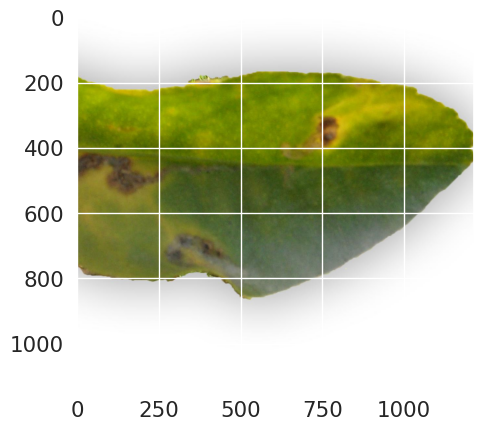

In [ ]:
temp_dir = os.path.join(root_path, 'split_aug', 'train', 'aug_Black spot')
img = image.load_img(os.path.join(temp_dir,os.listdir(temp_dir)[0]))
plt.imshow(img)

In [ ]:
cv2.imread(os.path.join(temp_dir,os.listdir(temp_dir)[0])).shape

(1133, 1216, 3)

In [ ]:
split_aug_path = os.path.join(root_path, 'split_aug') #"/content/drive/MyDrive/Undergrad Thesis/Aug_split_fix"
fnames = os.listdir(split_aug_path)
len(fnames)

3

In [ ]:
fnames

['test', 'train', 'val']

In [ ]:
fnames
split_aug = os.listdir(os.path.join(split_aug_path, fnames[0]))
split_aug

['aug_Black spot', 'aug_canker', 'aug_greening', 'aug_new_healthy_citrus']

Custom Model

In [ ]:
def create_model():
    model = Sequential()

    model.add(Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(224, 224, 3)))
    model.add(MaxPooling2D(pool_size=2, strides=2))

    model.add(Conv2D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=2, strides=2))
    model.add(Dropout(rate=0.20))

    model.add(Flatten())

    model.add(Dense(units=128, activation='relu'))
    model.add(Dropout(rate=0.25))
    model.add(Dense(units=4, activation='softmax'))

    # model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    # reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

    return model

In [ ]:
model = create_model()

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_96 (Conv2D)          (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 111, 111, 32)     0         
 2D)                                                             
                                                                 
 conv2d_97 (Conv2D)          (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 dropout_2 (Dropout)         (None, 54, 54, 64)        0         
                                                                 
 flatten_1 (Flatten)         (None, 186624)           

In [ ]:
# plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,  # Rescale pixel values to the range [0, 1]
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'train'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',  # Using 'categorical' for multi-class classification
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'val'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'test'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20


2024-01-03 06:21:06.075905: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_2/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


62/62 [==============================] - 35s 532ms/step - loss: 1.1816 - accuracy: 0.4872 - val_loss: 0.8222 - val_accuracy: 0.6286 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 33s 524ms/step - loss: 0.7878 - accuracy: 0.6273 - val_loss: 0.6593 - val_accuracy: 0.6976 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 33s 528ms/step - loss: 0.6893 - accuracy: 0.6851 - val_loss: 0.6580 - val_accuracy: 0.6810 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 32s 519ms/step - loss: 0.6089 - accuracy: 0.7224 - val_loss: 0.5321 - val_accuracy: 0.7548 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 32s 513ms/step - loss: 0.5816 - accuracy: 0.7306 - val_loss: 0.5689 - val_accuracy: 0.7143 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 32s 509ms/step - loss: 0.5262 - accuracy: 0.7536 - val_loss: 0.4124 - val_accuracy: 0.8214 - lr: 1.0000e-04
Epoch 7/20
62/62 [==============================] -

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'Custom_cnn.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy}")

14/14 [==============================] - 4s 259ms/step - loss: 0.1755 - accuracy: 0.9316
Test Accuracy: 0.9316037893295288


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9261904954910278
Corresponding Training Accuracy: 0.8834356069564819


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'Custom_cnn.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy}")

14/14 [==============================] - 4s 258ms/step - loss: 0.1755 - accuracy: 0.9316
Test Accuracy: 0.9316037893295288


14/14 [==============================] - 3s 245ms/step


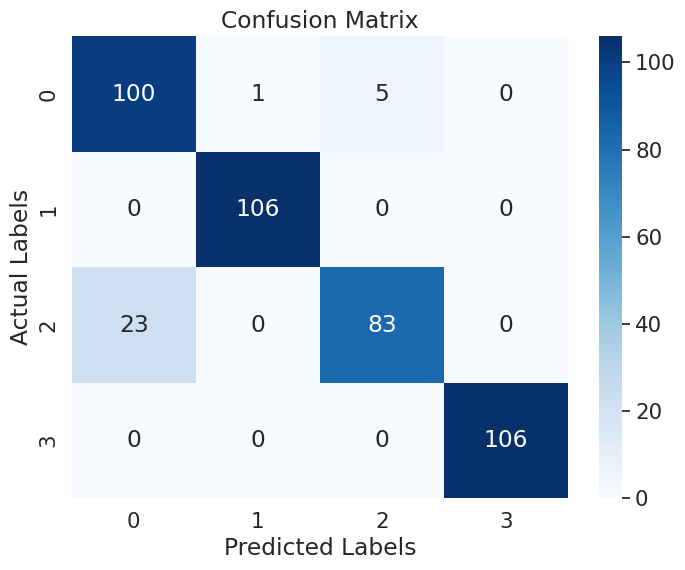

              precision    recall  f1-score   support

           0       0.81      0.94      0.87       106
           1       0.99      1.00      1.00       106
           2       0.94      0.78      0.86       106
           3       1.00      1.00      1.00       106

    accuracy                           0.93       424
   macro avg       0.94      0.93      0.93       424
weighted avg       0.94      0.93      0.93       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)


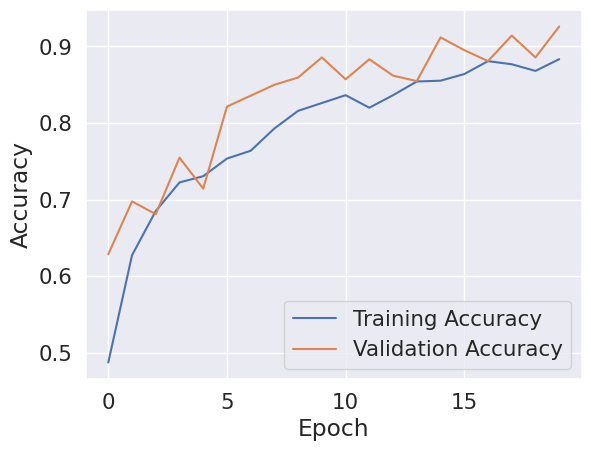

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
# print(os.getcwd())

PRE TRAINED MODELS

RESNET 50

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_10[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

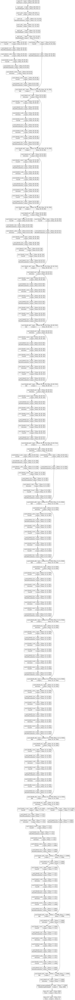

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20
62/62 [==============================] - 64s 555ms/step - loss: 0.3049 - accuracy: 0.8834 - val_loss: 2.1436 - val_accuracy: 0.3143 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 34s 547ms/step - loss: 0.0898 - accuracy: 0.9657 - val_loss: 2.3987 - val_accuracy: 0.2786 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 32s 513ms/step - loss: 0.0643 - accuracy: 0.9755 - val_loss: 2.2465 - val_accuracy: 0.2500 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 33s 537ms/step - loss: 0.0832 - accuracy: 0.9724 - val_loss: 1.7412 - val_accuracy: 0.2524 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 33s 526ms/step - loss: 0.0660 - accuracy: 0.9796 - val_loss: 2.7797 - val_accuracy: 0.2500 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 33s 525ms/step - loss: 0.0561 - accuracy: 0.9780 - val_loss: 3.3861 - val_accuracy: 0.4452 - lr: 1.0000e-04
Epoch 7/20
62/62 [======================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'Resnet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 3s 233ms/step - loss: 0.0498 - accuracy: 0.9858
Test Loss: 0.04979700595140457
Test Accuracy: 0.9858490824699402


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9904761910438538
Corresponding Training Accuracy: 0.9948875308036804


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'Resnet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 225ms/step - loss: 0.0498 - accuracy: 0.9858
Test Loss: 0.04979700595140457
Test Accuracy: 0.9858490824699402


14/14 [==============================] - 4s 227ms/step


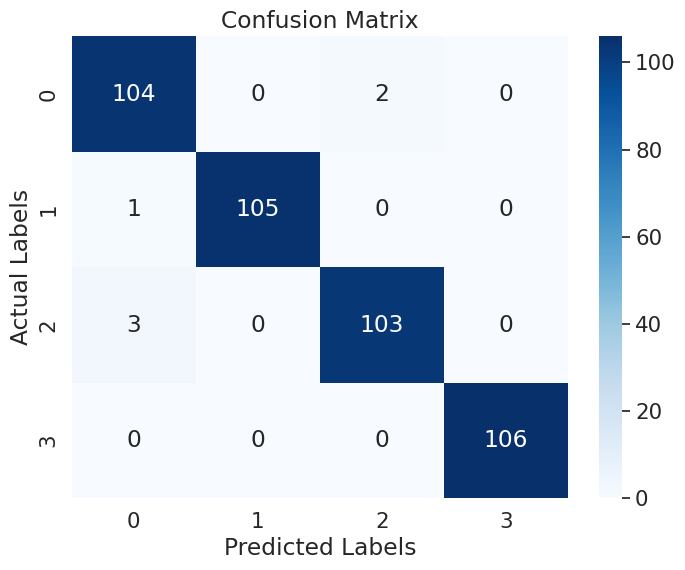

              precision    recall  f1-score   support

           0       0.96      0.98      0.97       106
           1       1.00      0.99      1.00       106
           2       0.98      0.97      0.98       106
           3       1.00      1.00      1.00       106

    accuracy                           0.99       424
   macro avg       0.99      0.99      0.99       424
weighted avg       0.99      0.99      0.99       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)


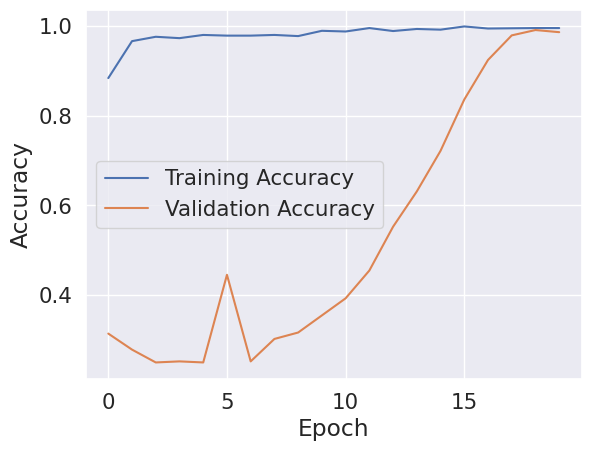

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

InceptionNet V3

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(299, 299),  # InceptionV3 input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(299, 299),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(299, 299),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(299, 299, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_98 (Conv2D)             (None, 149, 149, 32  864         ['input_11[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_94 (BatchN  (None, 149, 149, 32  96         ['conv2d_98[0][0]']              
 ormalization)                  )                                                          

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20
62/62 [==============================] - 72s 733ms/step - loss: 0.3668 - accuracy: 0.8512 - val_loss: 0.4201 - val_accuracy: 0.8762 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 44s 708ms/step - loss: 0.1090 - accuracy: 0.9586 - val_loss: 0.0981 - val_accuracy: 0.9643 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 44s 713ms/step - loss: 0.0921 - accuracy: 0.9693 - val_loss: 0.0423 - val_accuracy: 0.9881 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 45s 717ms/step - loss: 0.0607 - accuracy: 0.9755 - val_loss: 0.1032 - val_accuracy: 0.9667 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 44s 714ms/step - loss: 0.0594 - accuracy: 0.9785 - val_loss: 0.0623 - val_accuracy: 0.9762 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 46s 743ms/step - loss: 0.0502 - accuracy: 0.9826 - val_loss: 0.1022 - val_accuracy: 0.9643 - lr: 1.0000e-04
Epoch 7/20
62/62 [======================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'inceptionNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 261ms/step - loss: 0.0318 - accuracy: 0.9906
Test Loss: 0.031848762184381485
Test Accuracy: 0.9905660152435303


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9904761910438538
Corresponding Training Accuracy: 0.9959100484848022


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'inceptionNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 5s 256ms/step - loss: 0.0318 - accuracy: 0.9906
Test Loss: 0.031848762184381485
Test Accuracy: 0.9905660152435303


14/14 [==============================] - 5s 272ms/step


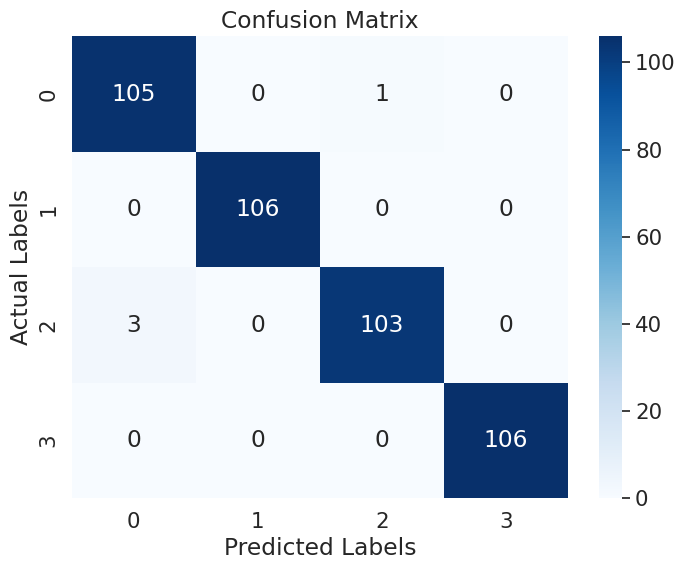

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       106
           1       1.00      1.00      1.00       106
           2       0.99      0.97      0.98       106
           3       1.00      1.00      1.00       106

    accuracy                           0.99       424
   macro avg       0.99      0.99      0.99       424
weighted avg       0.99      0.99      0.99       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

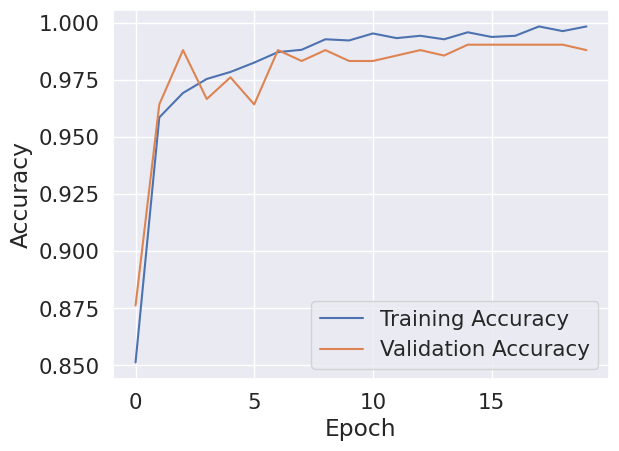

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

VGG16


In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # VGG16 input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0  

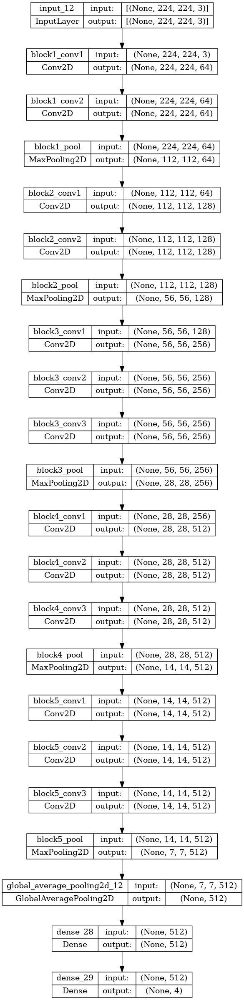

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20
62/62 [==============================] - 38s 547ms/step - loss: 0.6611 - accuracy: 0.6805 - val_loss: 0.4425 - val_accuracy: 0.7857 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 34s 541ms/step - loss: 0.3859 - accuracy: 0.8226 - val_loss: 0.2316 - val_accuracy: 0.9286 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 33s 529ms/step - loss: 0.2445 - accuracy: 0.9121 - val_loss: 0.3678 - val_accuracy: 0.8976 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 35s 554ms/step - loss: 0.1895 - accuracy: 0.9330 - val_loss: 0.1344 - val_accuracy: 0.9500 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 34s 542ms/step - loss: 0.1251 - accuracy: 0.9586 - val_loss: 0.6089 - val_accuracy: 0.7524 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 34s 538ms/step - loss: 0.1950 - accuracy: 0.9254 - val_loss: 0.0875 - val_accuracy: 0.9667 - lr: 1.0000e-04
Epoch 7/20
62/62 [======================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'vgg.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 261ms/step - loss: 0.0481 - accuracy: 0.9835
Test Loss: 0.04811554029583931
Test Accuracy: 0.9834905862808228


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.988095223903656
Corresponding Training Accuracy: 0.988752543926239


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'vgg.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 253ms/step - loss: 0.0481 - accuracy: 0.9835
Test Loss: 0.04811554029583931
Test Accuracy: 0.9834905862808228


14/14 [==============================] - 4s 275ms/step


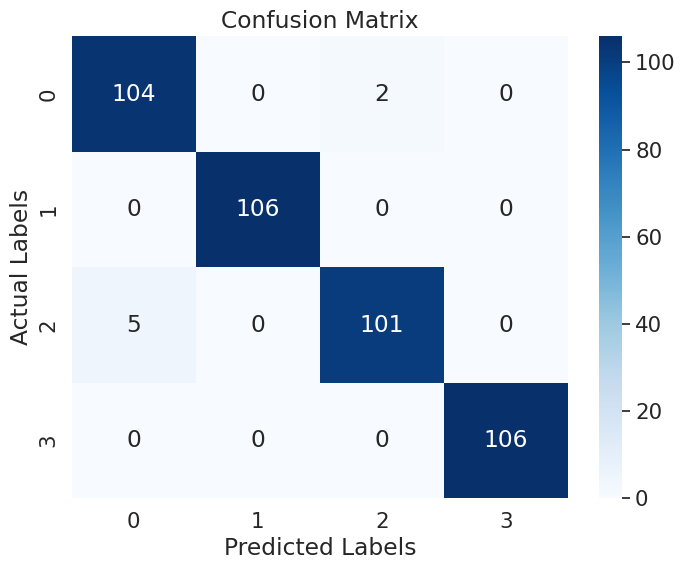

              precision    recall  f1-score   support

           0       0.95      0.98      0.97       106
           1       1.00      1.00      1.00       106
           2       0.98      0.95      0.97       106
           3       1.00      1.00      1.00       106

    accuracy                           0.98       424
   macro avg       0.98      0.98      0.98       424
weighted avg       0.98      0.98      0.98       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

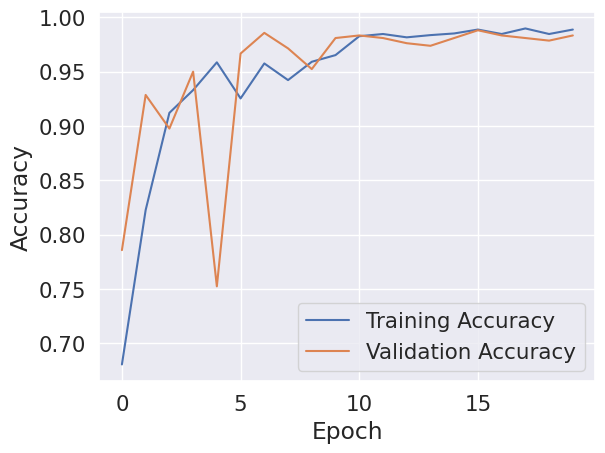

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

DenseNet121

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # DenseNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(lr=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
62/62 [==============================] - 88s 576ms/step - loss: 0.3905 - accuracy: 0.8635 - val_loss: 5079.3672 - val_accuracy: 0.2500 - lr: 0.0010
Epoch 2/20
62/62 [==============================] - 35s 561ms/step - loss: 0.2196 - accuracy: 0.9248 - val_loss: 9.4463 - val_accuracy: 0.6405 - lr: 0.0010
Epoch 3/20
62/62 [==============================] - 34s 542ms/step - loss: 0.2800 - accuracy: 0.9146 - val_loss: 1648.2933 - val_accuracy: 0.2619 - lr: 0.0010
Epoch 4/20
62/62 [==============================] - 33s 532ms/step - loss: 0.2555 - accuracy: 0.9146 - val_loss: 4.6673 - val_accuracy: 0.5405 - lr: 0.0010
Epoch 5/20
62/62 [==============================] - 35s 559ms/step - loss: 0.2059 - accuracy: 0.9325 - val_loss: 72.1139 - val_accuracy: 0.2500 - lr: 0.0010
Epoch 6/20
62/62 [==============================] - 33s 533ms/step - loss: 0.1919 - accuracy: 0.9289 - val_loss: 4.0298 - val_accuracy: 0.6881 - lr: 0.0010
Epoch 7/20
62/62 [==============================] - 33s 5

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'denseNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 249ms/step - loss: 0.2099 - accuracy: 0.9222
Test Loss: 0.20993009209632874
Test Accuracy: 0.9221698045730591


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9904761910438538
Corresponding Training Accuracy: 0.9677914381027222


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'denseNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 235ms/step - loss: 0.2099 - accuracy: 0.9222
Test Loss: 0.20993009209632874
Test Accuracy: 0.9221698045730591


14/14 [==============================] - 5s 249ms/step


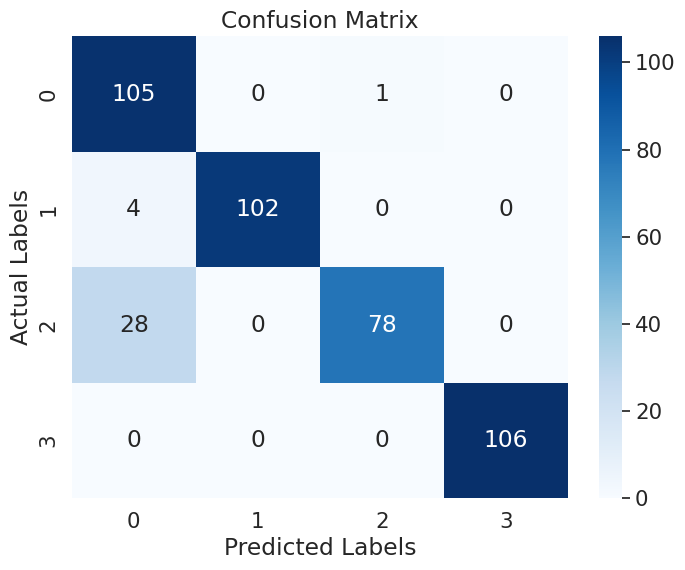

              precision    recall  f1-score   support

           0       0.77      0.99      0.86       106
           1       1.00      0.96      0.98       106
           2       0.99      0.74      0.84       106
           3       1.00      1.00      1.00       106

    accuracy                           0.92       424
   macro avg       0.94      0.92      0.92       424
weighted avg       0.94      0.92      0.92       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

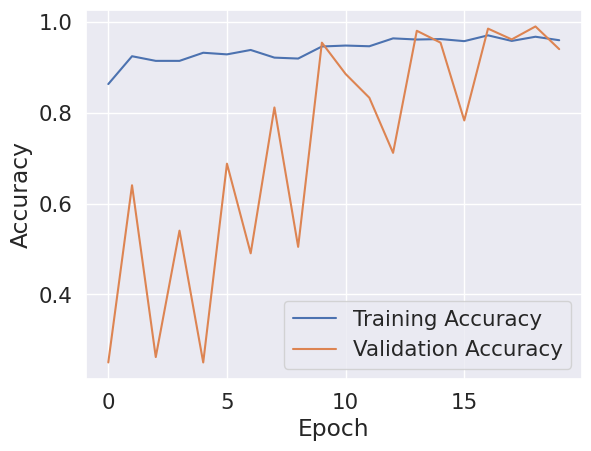

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

MobileNet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
# from tensorflow.keras.models import load_model, save_model

# # Assuming you have a trained model named 'model'
# model.save(os.path.join(dataset_path,'../mobileNet.h5'))  # Save the model to a file

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(lr=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                                   

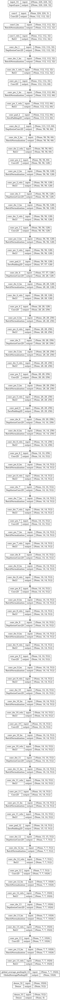

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
62/62 [==============================] - 44s 535ms/step - loss: 0.4771 - accuracy: 0.8236 - val_loss: 2.7300 - val_accuracy: 0.6143 - lr: 0.0010
Epoch 2/20
62/62 [==============================] - 32s 510ms/step - loss: 0.2677 - accuracy: 0.9080 - val_loss: 1.2829 - val_accuracy: 0.7476 - lr: 0.0010
Epoch 3/20
62/62 [==============================] - 33s 525ms/step - loss: 0.1501 - accuracy: 0.9473 - val_loss: 1.7750 - val_accuracy: 0.6929 - lr: 0.0010
Epoch 4/20
62/62 [==============================] - 34s 546ms/step - loss: 0.1923 - accuracy: 0.9315 - val_loss: 2.5546 - val_accuracy: 0.6929 - lr: 0.0010
Epoch 5/20
62/62 [==============================] - 34s 549ms/step - loss: 0.1632 - accuracy: 0.9463 - val_loss: 1.2121 - val_accuracy: 0.7095 - lr: 0.0010
Epoch 6/20
62/62 [==============================] - 33s 531ms/step - loss: 0.1650 - accuracy: 0.9479 - val_loss: 0.7525 - val_accuracy: 0.8667 - lr: 0.0010
Epoch 7/20
62/62 [==============================] - 33s 537ms/st

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'mobileNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 3s 238ms/step - loss: 0.0468 - accuracy: 0.9811
Test Loss: 0.046782322227954865
Test Accuracy: 0.9811320900917053


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.988095223903656
Corresponding Training Accuracy: 0.9734151363372803


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'mobileNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 3s 229ms/step - loss: 0.0468 - accuracy: 0.9811
Test Loss: 0.046782322227954865
Test Accuracy: 0.9811320900917053


14/14 [==============================] - 4s 248ms/step


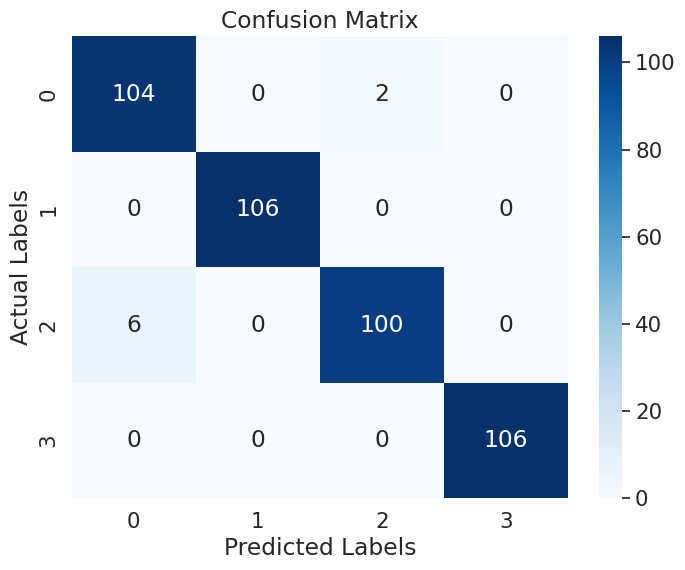

              precision    recall  f1-score   support

           0       0.95      0.98      0.96       106
           1       1.00      1.00      1.00       106
           2       0.98      0.94      0.96       106
           3       1.00      1.00      1.00       106

    accuracy                           0.98       424
   macro avg       0.98      0.98      0.98       424
weighted avg       0.98      0.98      0.98       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

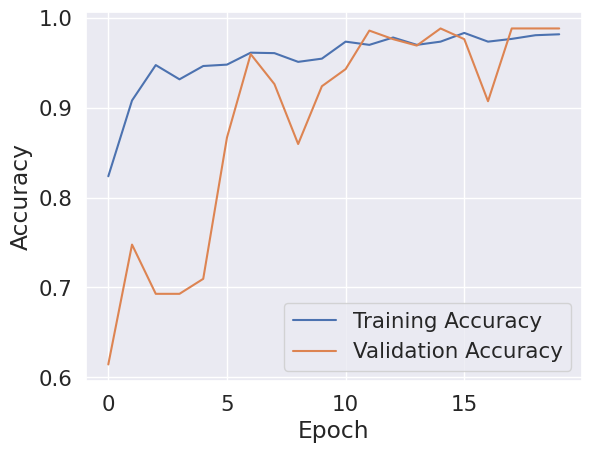

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

EfficientNet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # EfficientNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
# Add custom classification layers on top of the EfficientNet base model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_8 (Rescaling)        (None, 224, 224, 3)  0           ['input_15[0][0]']               
                                                                                                  
 normalization_4 (Normalization  (None, 224, 224, 3)  7          ['rescaling_8[0][0]']            
 )                                                                                                
                                                                                           

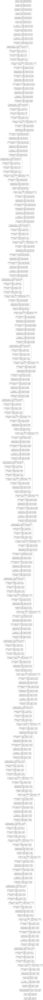

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-03 07:35:53.539660: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_15/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


62/62 [==============================] - 68s 573ms/step - loss: 0.5512 - accuracy: 0.8113 - val_loss: 1.4204 - val_accuracy: 0.2500 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 34s 539ms/step - loss: 0.1849 - accuracy: 0.9371 - val_loss: 1.4071 - val_accuracy: 0.2762 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 33s 535ms/step - loss: 0.1160 - accuracy: 0.9637 - val_loss: 1.6640 - val_accuracy: 0.2500 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 34s 541ms/step - loss: 0.0971 - accuracy: 0.9678 - val_loss: 1.6121 - val_accuracy: 0.2476 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 34s 548ms/step - loss: 0.0792 - accuracy: 0.9709 - val_loss: 1.7152 - val_accuracy: 0.2429 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 34s 545ms/step - loss: 0.0701 - accuracy: 0.9765 - val_loss: 1.5862 - val_accuracy: 0.2976 - lr: 5.0000e-05
Epoch 7/20
62/62 [==============================] -

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'efficientnet.h5'))  # Save the model to a file


TypeError: ignored

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

In [ ]:
loaded_model = load_model(os.path.join(weights_path,'efficientNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

EfficientNet B7

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=8,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
# from tensorflow.keras.applications import EfficientNetB7
# from tensorflow.keras.applications.efficientnet import preprocess_input

base_model = EfficientNetB7(weights='imagenet', include_top=False, input_shape=(224, 224, 3))  # EfficientNet B7 has a different input size

In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

# Other parts of the code (data generators, training, evaluation) remain the same.


In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_27"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_26 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_22 (Rescaling)       (None, 224, 224, 3)  0           ['input_26[0][0]']               
                                                                                                  
 normalization_11 (Normalizatio  (None, 224, 224, 3)  7          ['rescaling_22[0][0]']           
 n)                                                                                               
                                                                                           

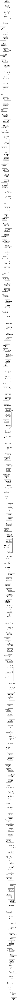

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-03 10:39:14.840607: W tensorflow/tsl/framework/bfc_allocator.cc:479] Allocator (GPU_0_bfc) ran out of memory trying to allocate 8.04MiB (rounded to 8429568)requested by op model_27/block5e_bn/FusedBatchNormV3
If the cause is memory fragmentation maybe the environment variable 'TF_GPU_ALLOCATOR=cuda_malloc_async' will improve the situation. 
Current allocation summary follows.
Current allocation summary follows.
2024-01-03 10:39:14.840954: I tensorflow/tsl/framework/bfc_allocator.cc:1034] BFCAllocator dump for GPU_0_bfc
2024-01-03 10:39:14.840990: I tensorflow/tsl/framework/bfc_allocator.cc:1041] Bin (256): 	Total Chunks: 1504, Chunks in use: 1464. 376.0KiB allocated for chunks. 366.0KiB in use in bin. 125.5KiB client-requested in use in bin.
2024-01-03 10:39:14.840999: I tensorflow/tsl/framework/bfc_allocator.cc:1041] Bin (512): 	Total Chunks: 2191, Chunks in use: 2178. 1.15MiB allocated for chunks. 1.14MiB in use in bin. 1.06MiB client-requested in use in bin.
2024-01-03 10:39

ResourceExhaustedError: ignored

w/tsl/framework/bfc_allocator.cc:1098] 6 Chunks of size 557056 totalling 3.19MiB
2024-01-03 10:39:14.987781: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 1 Chunks of size 566784 totalling 553.5KiB
2024-01-03 10:39:14.987785: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 6 Chunks of size 573440 totalling 3.28MiB
2024-01-03 10:39:14.987789: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 2 Chunks of size 577536 totalling 1.10MiB
2024-01-03 10:39:14.987792: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 9 Chunks of size 589824 totalling 5.06MiB
2024-01-03 10:39:14.987797: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 8 Chunks of size 606208 totalling 4.62MiB
2024-01-03 10:39:14.987800: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 76 Chunks of size 614400 totalling 44.53MiB
2024-01-03 10:39:14.987804: I tensorflow/tsl/framework/bfc_allocator.cc:1098] 5 Chunks of size 622592 totalling 2.97MiB
2024-01-03 10:39:14.987808: I tensorflow/tsl/framework/bfc_allocator.cc:1098

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'EfficientB7Net.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

In [ ]:
loaded_model = load_model(os.path.join(weights_path,'EfficientB7Net.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

DenseNet201

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=8,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = DenseNet201(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_24"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_23 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_8 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_23[0][0]']               
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_8[0][0]']       
                                )                                                          

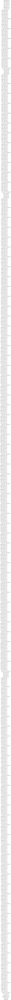

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
245/245 [==============================] - 150s 217ms/step - loss: 0.3298 - accuracy: 0.8671 - val_loss: 0.2114 - val_accuracy: 0.9143 - lr: 1.0000e-04
Epoch 2/20
245/245 [==============================] - 47s 190ms/step - loss: 0.1720 - accuracy: 0.9361 - val_loss: 0.1742 - val_accuracy: 0.9429 - lr: 1.0000e-04
Epoch 3/20
245/245 [==============================] - 48s 198ms/step - loss: 0.1243 - accuracy: 0.9545 - val_loss: 0.1399 - val_accuracy: 0.9548 - lr: 1.0000e-04
Epoch 4/20
245/245 [==============================] - 47s 190ms/step - loss: 0.1248 - accuracy: 0.9581 - val_loss: 0.0591 - val_accuracy: 0.9762 - lr: 1.0000e-04
Epoch 5/20
245/245 [==============================] - 46s 188ms/step - loss: 0.1069 - accuracy: 0.9627 - val_loss: 0.0395 - val_accuracy: 0.9857 - lr: 1.0000e-04
Epoch 6/20
245/245 [==============================] - 46s 185ms/step - loss: 0.1020 - accuracy: 0.9663 - val_loss: 0.0629 - val_accuracy: 0.9714 - lr: 1.0000e-04
Epoch 7/20
245/245 [=======

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'denseNet201.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

53/53 [==============================] - 4s 72ms/step - loss: 0.0282 - accuracy: 0.9906
Test Loss: 0.028225911781191826
Test Accuracy: 0.9905660152435303


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9904761910438538
Corresponding Training Accuracy: 0.9892638325691223


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'denseNet201.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

53/53 [==============================] - 7s 68ms/step - loss: 0.0282 - accuracy: 0.9906
Test Loss: 0.028225911781191826
Test Accuracy: 0.9905660152435303


53/53 [==============================] - 6s 74ms/step


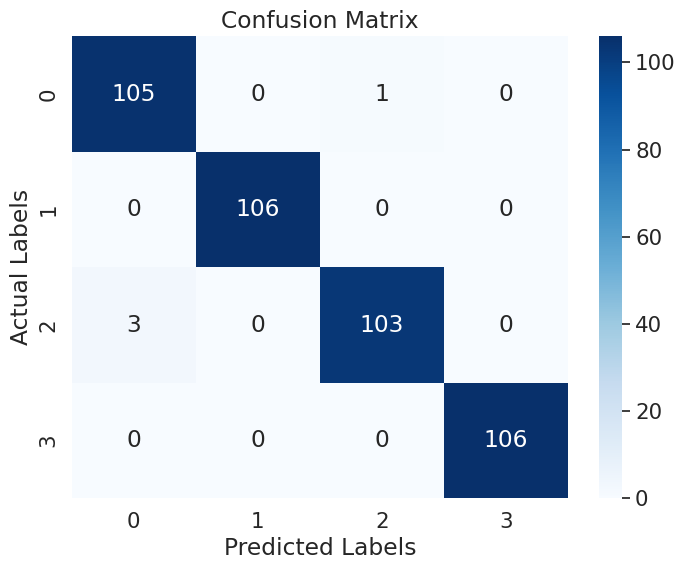

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       106
           1       1.00      1.00      1.00       106
           2       0.99      0.97      0.98       106
           3       1.00      1.00      1.00       106

    accuracy                           0.99       424
   macro avg       0.99      0.99      0.99       424
weighted avg       0.99      0.99      0.99       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

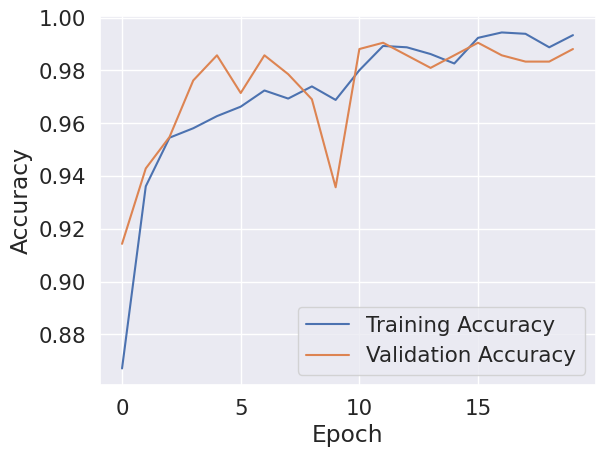

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

InceptionResnet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

219055592/219055592 [==============================] - 126s 1us/step


In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_21"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_20 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_192 (Conv2D)            (None, 111, 111, 32  864         ['input_20[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_188 (Batch  (None, 111, 111, 32  96         ['conv2d_192[0][0]']             
 Normalization)                 )                                                          

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
62/62 [==============================] - 320s 4s/step - loss: 0.3847 - accuracy: 0.8528 - val_loss: 0.1777 - val_accuracy: 0.9524 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 35s 565ms/step - loss: 0.1249 - accuracy: 0.9627 - val_loss: 0.0575 - val_accuracy: 0.9738 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 35s 564ms/step - loss: 0.0761 - accuracy: 0.9719 - val_loss: 0.0740 - val_accuracy: 0.9833 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 35s 564ms/step - loss: 0.0628 - accuracy: 0.9770 - val_loss: 0.1459 - val_accuracy: 0.9595 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 35s 559ms/step - loss: 0.0672 - accuracy: 0.9780 - val_loss: 0.1317 - val_accuracy: 0.9548 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 36s 574ms/step - loss: 0.0423 - accuracy: 0.9826 - val_loss: 0.0357 - val_accuracy: 0.9905 - lr: 5.0000e-05
Epoch 7/20
62/62 [========================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'InceptionResNetV2.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 280ms/step - loss: 0.0466 - accuracy: 0.9906
Test Loss: 0.04656537249684334
Test Accuracy: 0.9905660152435303


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9904761910438538
Corresponding Training Accuracy: 0.9826176166534424


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'InceptionResNetV2.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 6s 222ms/step - loss: 0.0466 - accuracy: 0.9906
Test Loss: 0.04656537249684334
Test Accuracy: 0.9905660152435303


14/14 [==============================] - 7s 264ms/step


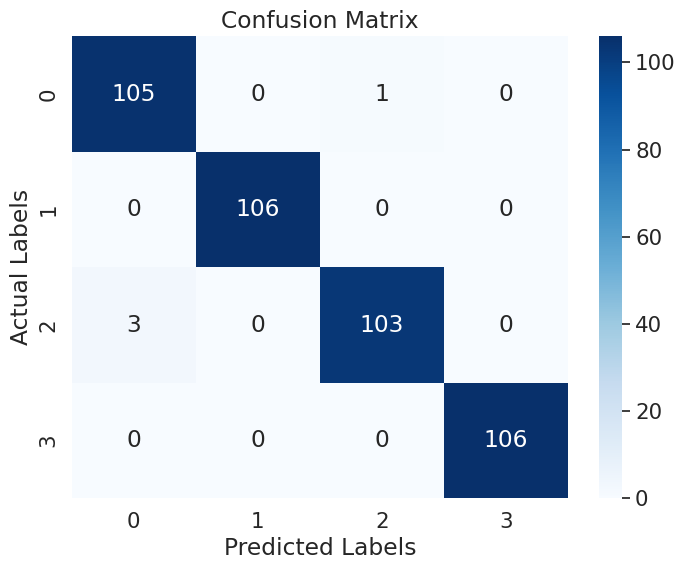

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       106
           1       1.00      1.00      1.00       106
           2       0.99      0.97      0.98       106
           3       1.00      1.00      1.00       106

    accuracy                           0.99       424
   macro avg       0.99      0.99      0.99       424
weighted avg       0.99      0.99      0.99       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

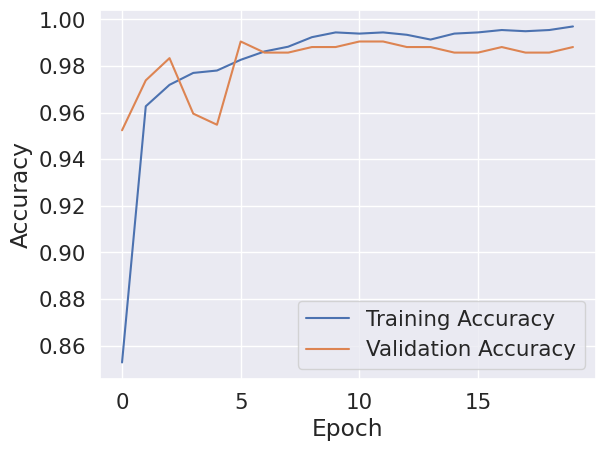

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

MobileNetV2

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1956 images belonging to 4 classes.
Found 420 images belonging to 4 classes.
Found 424 images belonging to 4 classes.


In [ ]:
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

2024-01-06 20:05:25.669875: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 20:05:25.670000: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 20:05:25.670052: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 20:05:27.207379: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 20:05:27.207951: I tensorflow/compile

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

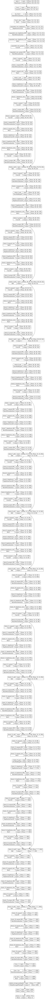

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-06 20:06:11.955183: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8101


62/62 [==============================] - 71s 691ms/step - loss: 0.5031 - accuracy: 0.7843 - val_loss: 1.2607 - val_accuracy: 0.5429 - lr: 1.0000e-04
Epoch 2/20
62/62 [==============================] - 34s 545ms/step - loss: 0.1953 - accuracy: 0.9202 - val_loss: 1.0924 - val_accuracy: 0.5905 - lr: 1.0000e-04
Epoch 3/20
62/62 [==============================] - 33s 533ms/step - loss: 0.1114 - accuracy: 0.9560 - val_loss: 1.2946 - val_accuracy: 0.5357 - lr: 1.0000e-04
Epoch 4/20
62/62 [==============================] - 34s 543ms/step - loss: 0.0963 - accuracy: 0.9627 - val_loss: 1.7454 - val_accuracy: 0.4714 - lr: 1.0000e-04
Epoch 5/20
62/62 [==============================] - 34s 540ms/step - loss: 0.0769 - accuracy: 0.9683 - val_loss: 2.2614 - val_accuracy: 0.4405 - lr: 1.0000e-04
Epoch 6/20
62/62 [==============================] - 34s 539ms/step - loss: 0.0736 - accuracy: 0.9714 - val_loss: 1.2280 - val_accuracy: 0.6190 - lr: 5.0000e-05
Epoch 7/20
62/62 [==============================] -

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'MobileNetV2.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 5s 323ms/step - loss: 0.4272 - accuracy: 0.8797
Test Loss: 0.42719775438308716
Test Accuracy: 0.8797169923782349


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.8880952596664429
Corresponding Training Accuracy: 0.9856850504875183


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'MobileNetV2.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

14/14 [==============================] - 4s 244ms/step - loss: 0.4272 - accuracy: 0.8797
Test Loss: 0.42719775438308716
Test Accuracy: 0.8797169923782349


14/14 [==============================] - 4s 245ms/step


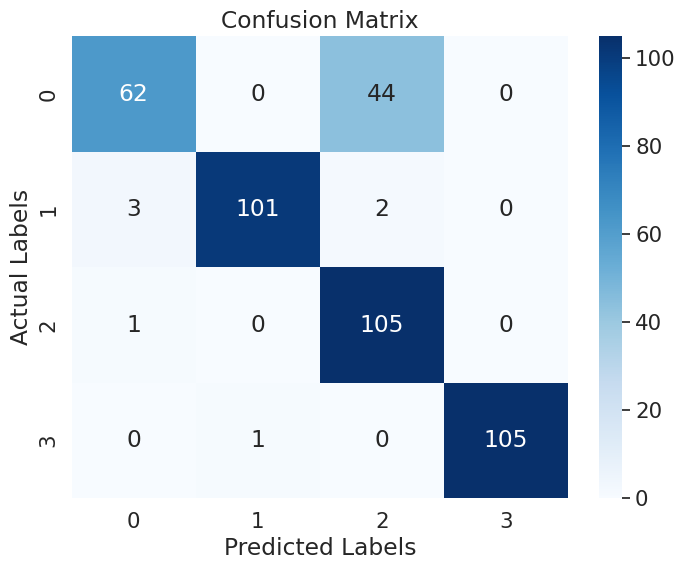

              precision    recall  f1-score   support

           0       0.94      0.58      0.72       106
           1       0.99      0.95      0.97       106
           2       0.70      0.99      0.82       106
           3       1.00      0.99      1.00       106

    accuracy                           0.88       424
   macro avg       0.91      0.88      0.88       424
weighted avg       0.91      0.88      0.88       424



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

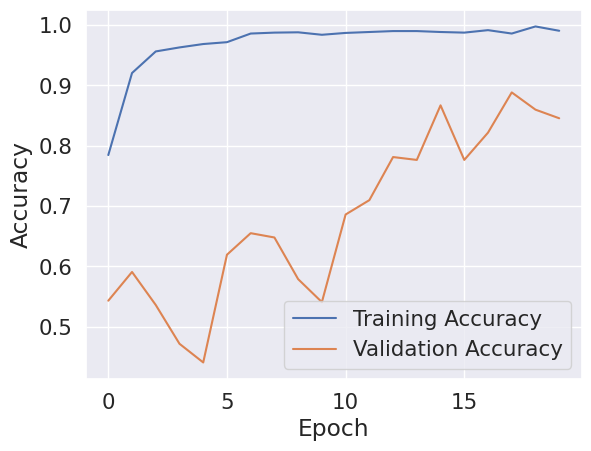

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()